# **Optimization on the scaled temperatures**

# Table of contents

## [1. Libraries import and Data preparation](#1)

## [2. Gradient descent](#2)

### [2.1 1990](#2.1)
####     [2.1.1 TOURS](#2.1.1)
####     [2.1.2 BUDAPEST](#2.1.2)
####     [2.1.3 ROMA](#2.1.3)

### [2.1 1960](#2.2)
#### [2.1.1 TOURS](#2.2.1)
#### [2.1.2 BUDAPEST](#2.2.2)
#### [2.1.3 ROMA](#2.2.3)

### [2.1 2009](#2.3)
#### [2.1.1 TOURS](#2.3.1)
#### [2.1.2 BUDAPEST](#2.3.2)
#### [2.1.3 ROMA](#2.3.3)


## 1. Libraries import and Data preparation
<div id='1'></div>

In [4]:
import pandas as pd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import os
from mpl_toolkits import mplot3d

from plotly.offline import download_plotlyjs, init_notebook_mode
from plotly.offline import plot, iplot
import plotly.graph_objects as go

In [5]:
#Create a path to where your data is stored.
path = r'C:\Users\dacol\Documents\Data Project - careerfoundry\ClimateWins_ML\02 Data'

In [8]:
#Read in the European weather data.
climate = pd.read_pickle(os.path.join(path, "Prepared Data",'Dataset_scaled.pkl'))
climate

,DATE,MONTH,BASEL_cloud_cover,BASEL_wind_speed,BASEL_humidity,BASEL_pressure,BASEL_global_radiation,BASEL_precipitation,BASEL_snow_depth,BASEL_sunshine,...,VALENTIA_cloud_cover,VALENTIA_humidity,VALENTIA_pressure,VALENTIA_global_radiation,VALENTIA_precipitation,VALENTIA_snow_depth,VALENTIA_sunshine,VALENTIA_temp_mean,VALENTIA_temp_min,VALENTIA_temp_max
0,1960-01-01,1,0.660514,-0.02793,0.826097,-0.001949,-1.101066,-0.265148,-0.179228,-0.902918,...,-0.443701,0.761754,-1.299744,-0.806427,-0.088407,-0.024706,0.372147,-0.668215,-0.519743,-0.752237
1,1960-01-02,1,0.244897,-0.02793,0.735760,-0.001949,-1.058108,1.658760,-0.179228,-0.810126,...,0.783085,1.183580,-1.262455,-1.042055,0.503361,-0.024706,-0.829285,-0.548046,-0.629054,-0.407141
2,1960-01-03,1,1.076130,-0.02793,1.277781,-0.001949,-1.251420,0.155707,-0.179228,-1.065304,...,0.783085,1.183580,-0.432779,-1.136306,-0.396127,-0.024706,-1.009500,-0.067372,0.054135,-0.177078
3,1960-01-04,1,-1.001953,-0.02793,1.458455,-0.001949,-0.821838,-0.445514,-0.179228,-0.114186,...,0.783085,0.480538,0.387574,-1.183432,0.669056,-0.024706,-1.039536,-0.998679,-0.164486,-0.838511
4,1960-01-05,1,0.244897,-0.02793,1.729466,-0.001949,-0.746661,-0.164944,-0.179228,0.187388,...,-1.670486,-0.363113,1.729970,-0.794645,-0.490810,-0.024706,0.672505,-1.509396,-1.339569,-1.471186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22945,2022-10-27,10,-1.833187,-0.02793,0.284075,1.037367,-0.005632,-0.004619,-0.179228,0.720943,...,-0.443701,-0.081896,-0.003958,-0.005290,-0.005560,-0.024706,-0.018319,-0.007287,-0.000520,-0.004530
22946,2022-10-28,10,0.244897,-0.02793,0.103401,0.976231,-0.005632,-0.004619,-0.179228,0.187388,...,-0.443701,-0.081896,-0.003958,-0.005290,-0.005560,-0.024706,-0.018319,-0.007287,-0.000520,-0.004530
22947,2022-10-29,10,-0.586336,-0.02793,0.013064,0.716402,-0.005632,-0.004619,-0.179228,0.349774,...,-0.443701,-0.081896,-0.003958,-0.005290,-0.005560,-0.024706,-0.018319,-0.007287,-0.000520,-0.004530
22948,2022-10-30,10,-0.170720,-0.02793,0.374412,0.487141,-0.005632,-0.004619,-0.179228,0.280180,...,-0.443701,-0.081896,-0.003958,-0.005290,-0.005560,-0.024706,-0.018319,-0.007287,-0.000520,-0.004530


In [10]:
#Reduce to just the mean temperatures and the selected stations
df = climate[['DATE', 'MONTH',
 'BUDAPEST_temp_mean',
 'ROMA_temp_mean',
 'TOURS_temp_mean'
]].copy()

In [12]:
df

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
0,1960-01-01,1,-1.099163,-1.280450,-0.257321
1,1960-01-02,1,-1.110927,-0.539569,-0.335759
2,1960-01-03,1,-1.063873,-0.876333,-0.210258
3,1960-01-04,1,-1.146217,-0.775304,-0.069069
4,1960-01-05,1,-1.087400,-0.926848,-0.037694
...,...,...,...,...,...
22945,2022-10-27,10,-0.005167,-0.000746,1.295755
22946,2022-10-28,10,-0.005167,-0.000746,1.358505
22947,2022-10-29,10,-0.005167,-0.000746,1.405568
22948,2022-10-30,10,-0.005167,-0.000746,0.668249


In [14]:
#Drop the DATE and MONTH data as those numbers are not scaled with the rest.
notemp = df.drop(['DATE','MONTH'], axis=1)

(array([1, 2, 3]),
 [Text(1, 0, 'BUDAPEST_temp_mean'),
  Text(2, 0, 'ROMA_temp_mean'),
  Text(3, 0, 'TOURS_temp_mean')])

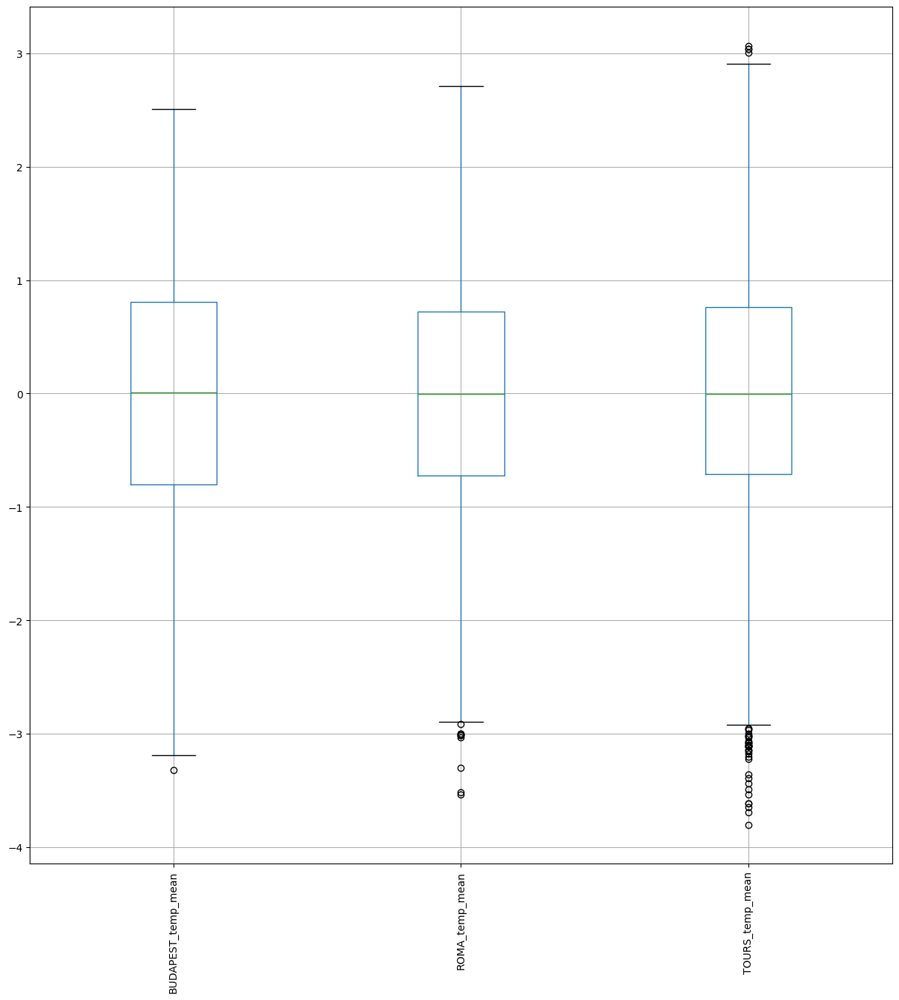

In [16]:
#Look at a whisker plot of the data to see variations in temperatures
notemp.boxplot(figsize=(15,15))
plt.xticks(rotation=90)

## 2. Gradient descent
<div id='2'></div>

### 2.1. 1990
<div id='2.1'></div>

In [20]:
#Reduce your dataset to a single year
dfyear = df[df['DATE'].astype(str).str.contains('1990')] #<-----INSERT YEAR HERE
dfyear

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
10958,1990-01-01,1,-1.369721,-1.937140,-1.528019
10959,1990-01-02,1,-1.428538,-1.566700,-1.292705
10960,1990-01-03,1,-1.440302,-1.600376,-1.261329
10961,1990-01-04,1,-1.616753,-1.583538,-1.386830
10962,1990-01-05,1,-1.687333,-1.886626,-1.135828
...,...,...,...,...,...
11318,1990-12-27,12,-1.299141,-1.246774,-0.712262
11319,1990-12-28,12,-1.169744,-1.263612,-0.759325
11320,1990-12-29,12,-1.463829,-1.566700,-0.100445
11321,1990-12-30,12,-1.263851,-0.960524,-0.382822


In [22]:
dfyear.describe()

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
count,365,365.000000,365.000000,365.000000,365.000000
mean,1990-07-02 00:00:00,6.526027,0.027964,0.038743,0.137621
min,1990-01-01 00:00:00,1.000000,-2.357847,-2.088684,-2.139837
25%,1990-04-02 00:00:00,4.000000,-0.640390,-0.893171,-0.649512
50%,1990-07-02 00:00:00,7.000000,0.077177,-0.051261,0.150558
75%,1990-10-01 00:00:00,10.000000,0.724164,1.026385,0.856501
max,1990-12-31 00:00:00,12.000000,1.876978,2.019839,2.644891
std,NaN,3.452584,0.906770,1.130786,0.980101


In [24]:
#Pick which weather station you want to use. Below is a 3D visualization of the temperatures for that year.

In [26]:
#Drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempyear = dfyear.drop(['DATE','MONTH'], axis=1)

In [30]:
#We need to make an index for the year. Create a set of data from 1 to 365 (or to 366 if it's a leap year!)
#We'll scale this by 100 as the index is made. This will help the gradient descent converge 366 = 3.66

i = np.arange(0.01,3.66,0.01) #<---needs to be one GREATER than the total number of days
index = pd.DataFrame(data = i, columns = ['index'])
index

,index
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
360,3.61
361,3.62
362,3.63
363,3.64


In [32]:
n_rows = dfyear.shape[0]
n_rows

365

#### 2.1.1 TOURS
<div id='2.1.1'></div>

In [35]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['TOURS_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [37]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['TOURS_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [41]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].min()

-2.1398366450172963

In [43]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].max()

2.6448908747721713

In [45]:
#This computes the loss function for the gradiant descent. DO NOT CHANGE!

def compute_cost(X, y, theta=np.array([[0],[0]])):
    """Given covariate matrix X, the prediction results y and coefficients theta
    compute the loss"""
    
    m = len(y)
    J=0 # initialize loss to zero
    
    # reshape theta
    theta=theta.reshape(2,1)
    
    # calculate the hypothesis - y_hat
    h_x = np.dot(X,theta)
    #print(h_x)
    
    # subtract y from y_hat, square and sum
    error_term = sum((h_x - y)**2)
    
    # divide by twice the number of samples - standard practice.
    loss = error_term/(2*m)
    
    return loss

In [47]:
compute_cost(X,y)

array([0.4884528])

In [49]:
#This is the gradiant descent function. DO NOT CHANGE!

def gradient_descent(X, y, theta=np.array([[0],[0]]),
                    alpha=0.01, num_iterations=1500):
    """
    Solve for theta using Gradient Descent optimiztion technique. 
    Alpha is the learning rate
    """
    m = len(y)
    J_history = []
    theta0_history = []
    theta1_history = []
    theta = theta.reshape(2,1)
    
    for i in range(num_iterations):
        error = (np.dot(X, theta) - y)
        
        term0 = (alpha/m) * sum(error* X[:,0].reshape(m,1))
        term1 = (alpha/m) * sum(error* X[:,1].reshape(m,1))
        
        # update theta
        term_vector = np.array([[term0],[term1]])
        #print(term_vector)
        theta = theta - term_vector.reshape(2,1)
        
        # store history values
        theta0_history.append(theta[0].tolist()[0])
        theta1_history.append(theta[1].tolist()[0])
        J_history.append(compute_cost(X,y,theta).tolist()[0])
        
    return (theta, J_history, theta0_history, theta1_history)

In [51]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 203 ms
Wall time: 469 ms


In [53]:
theta

array([[0.01605692],
       [0.06642824]])

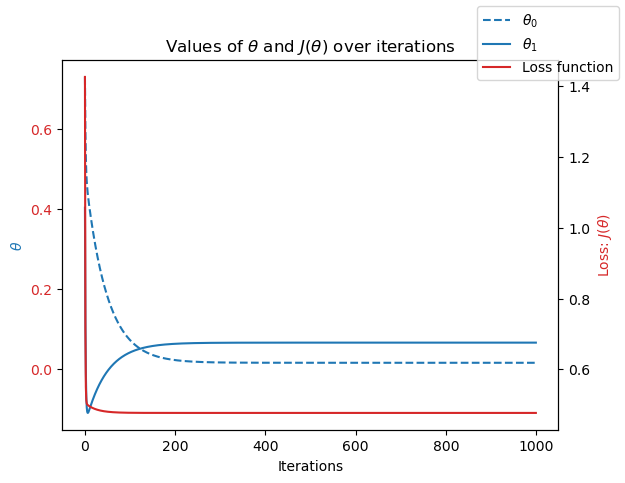


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: 0.0161
Optimal Theta 1: 0.0664
Minimal cost: 0.4765
Iteration of minimal cost: 849


In [55]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 849 iteration, lets set it to 9000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [58]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 828 ms
Wall time: 1.55 s


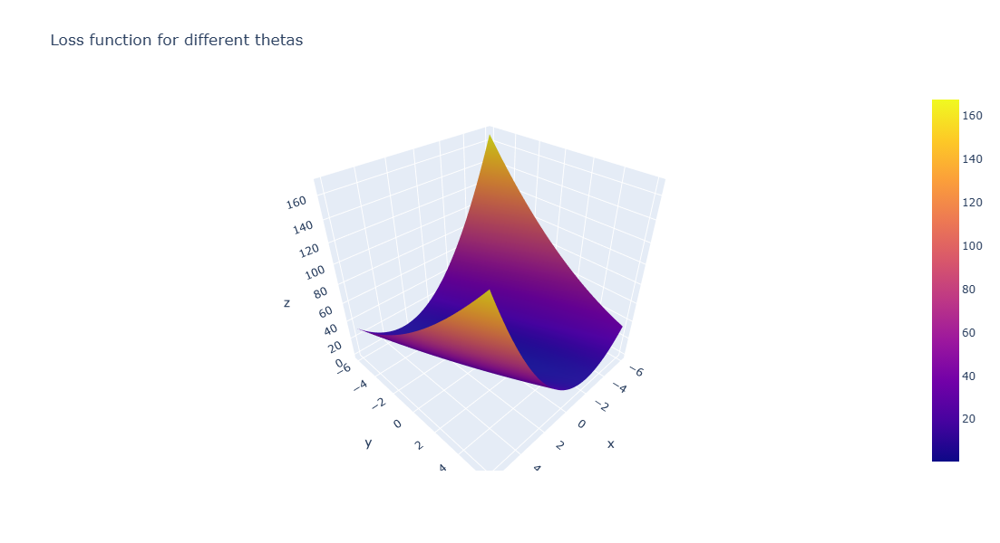

In [59]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [62]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=9000 #<---start with the same iterations as above
theta_init=np.array([[0.0161],[0.0664]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

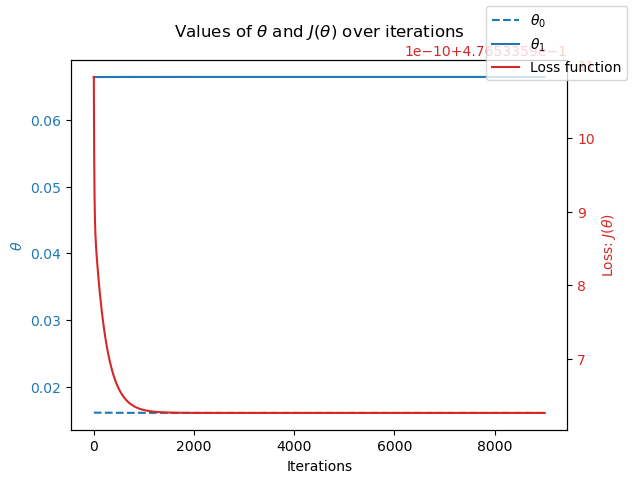


--- Optimization Results ---
Number of iterations: 9000
Learning rate (alpha): 0.01

Optimal Theta 0: 0.0161
Optimal Theta 1: 0.0664
Minimal cost: 0.4765
Iteration of minimal cost: 6004


In [66]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [68]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.31 s
Wall time: 3.25 s


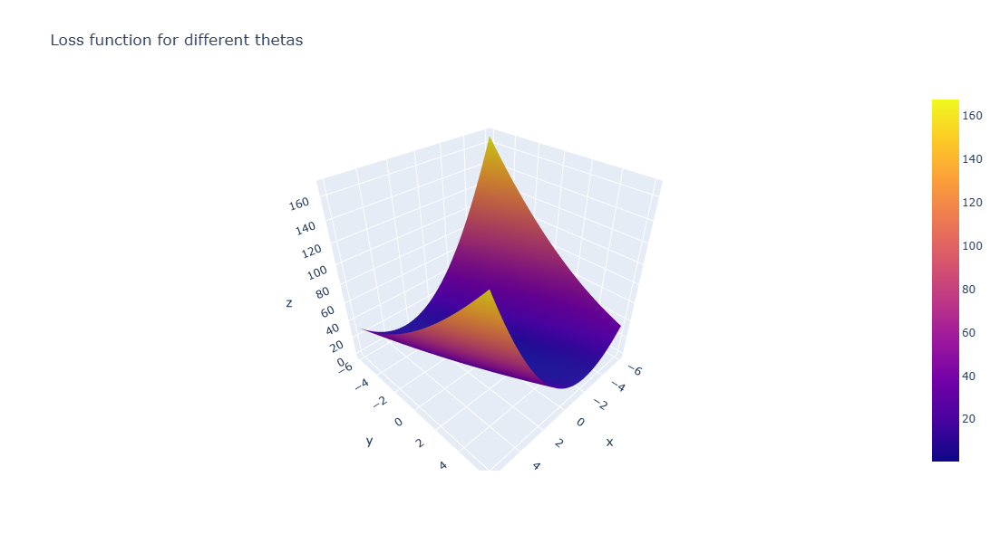

In [70]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

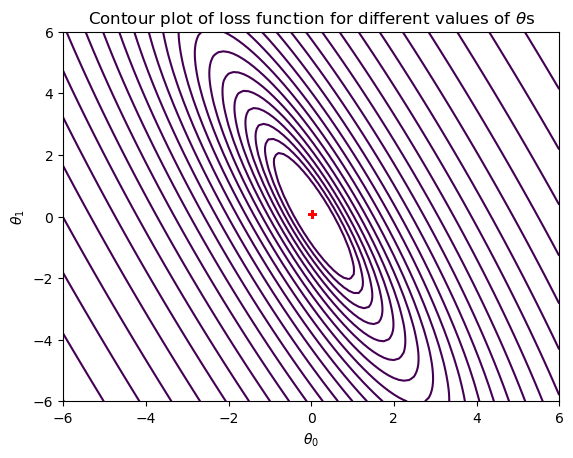

In [72]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.1.2 BUDAPEST
<div id='2.1.2'></div>

In [75]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['BUDAPEST_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [77]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['BUDAPEST_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [81]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].min()

-2.357847310099167

In [83]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].max()

1.8769778399067711

In [85]:
compute_cost(X,y)

array([0.41038062])

In [87]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 359 ms
Wall time: 921 ms


In [89]:
theta

array([[-0.0805865 ],
       [ 0.05931734]])

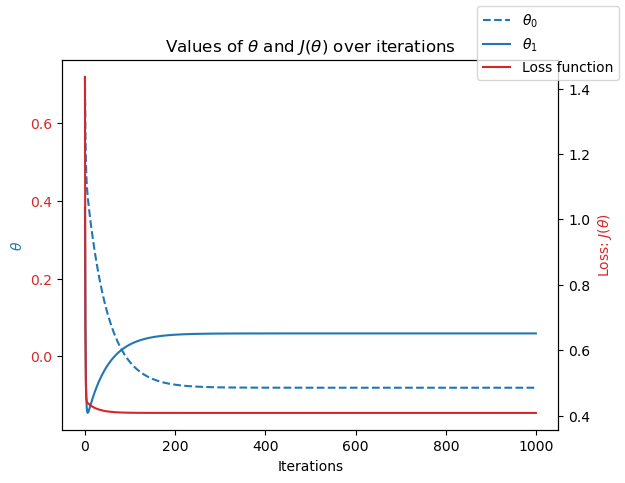


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.0806
Optimal Theta 1: 0.0593
Minimal cost: 0.4080
Iteration of minimal cost: 845


In [91]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 845 iteration, lets set it to 9000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [94]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.33 s
Wall time: 2.68 s


In [ ]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [98]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=9000 #<---start with the same iterations as above
theta_init=np.array([[-0.0806],[0.0593]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

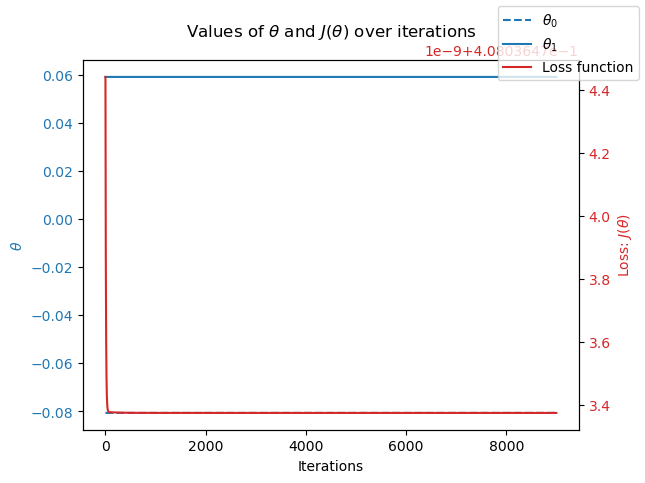


--- Optimization Results ---
Number of iterations: 9000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.0806
Optimal Theta 1: 0.0593
Minimal cost: 0.4080
Iteration of minimal cost: 4881


In [102]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [104]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.09 s
Wall time: 2.92 s


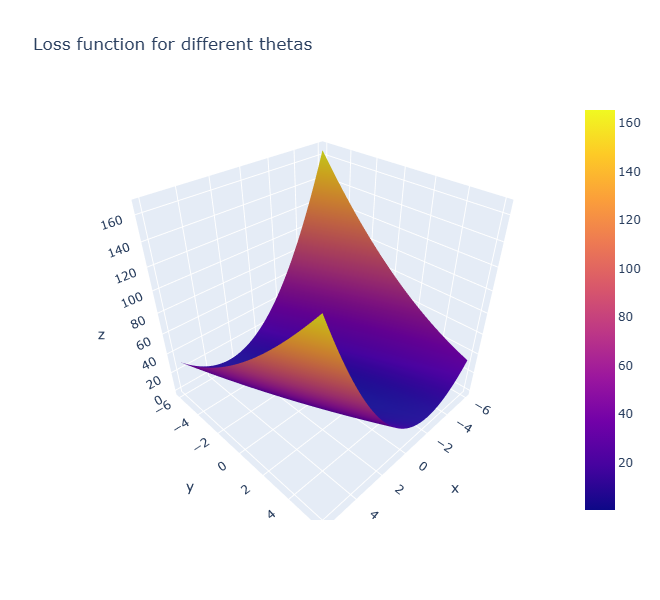

In [105]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

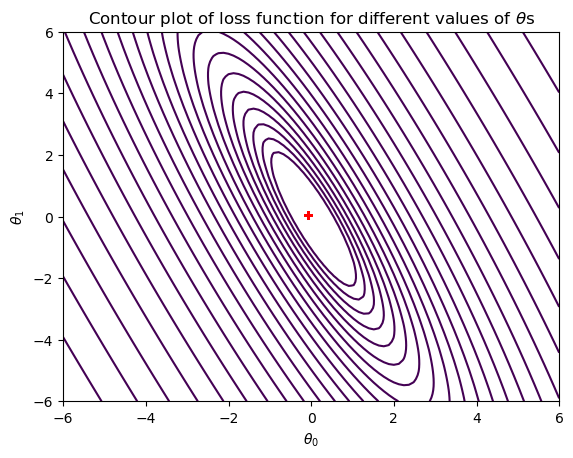

In [108]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.1.3 ROMA
<div id='2.1.3'></div>

In [111]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['ROMA_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [113]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['ROMA_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [117]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].min()

-2.0886841879872984

In [119]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].max()

2.019839020877644

In [121]:
compute_cost(X,y)

array([0.63833699])

In [123]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 297 ms
Wall time: 919 ms


In [125]:
theta

array([[-0.38295274],
       [ 0.23043478]])

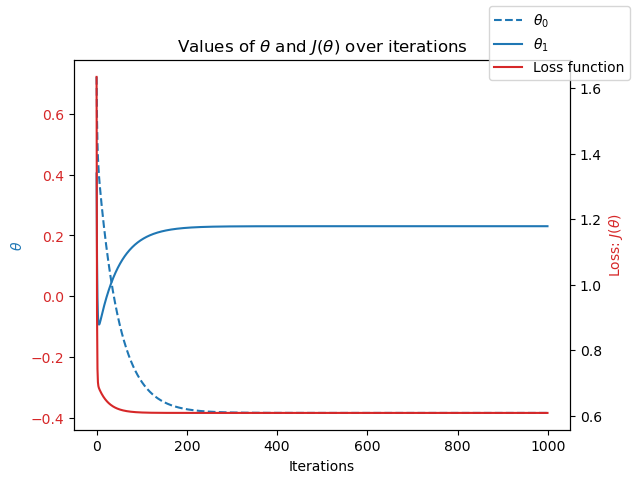


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.3830
Optimal Theta 1: 0.2304
Minimal cost: 0.6081
Iteration of minimal cost: 987


In [127]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 987 iteration, lets set it to 10000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [130]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.28 s
Wall time: 2.93 s


In [ ]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [134]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=10000 #<---start with the same iterations as above
theta_init=np.array([[-0.3830],[0.2304]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

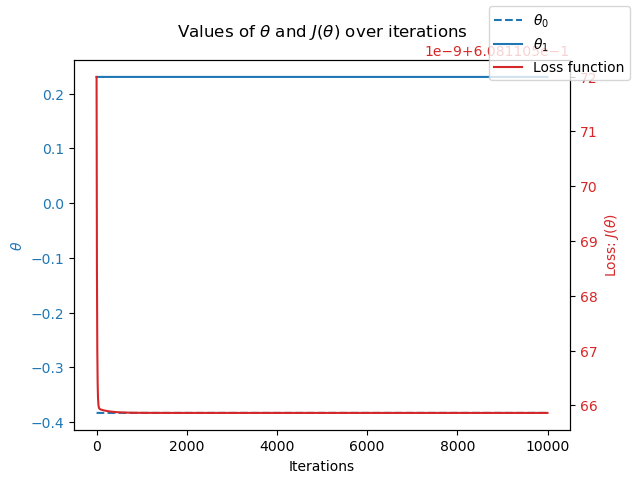


--- Optimization Results ---
Number of iterations: 10000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.3830
Optimal Theta 1: 0.2304
Minimal cost: 0.6081
Iteration of minimal cost: 6082


In [138]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [140]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.05 s
Wall time: 2.84 s


In [ ]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

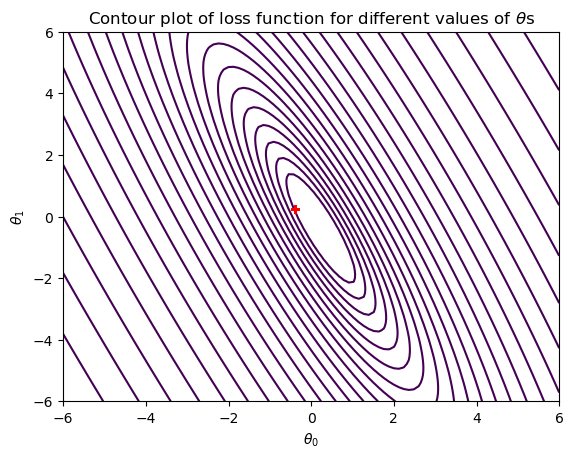

In [144]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

### 2.2 1960
<div id='2.2'></div>

In [147]:
#Reduce your dataset to a single year
dfyear = df[df['DATE'].astype(str).str.contains('1960')] #<-----INSERT YEAR HERE
dfyear

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
0,1960-01-01,1,-1.099163,-1.280450,-0.257321
1,1960-01-02,1,-1.110927,-0.539569,-0.335759
2,1960-01-03,1,-1.063873,-0.876333,-0.210258
3,1960-01-04,1,-1.146217,-0.775304,-0.069069
4,1960-01-05,1,-1.087400,-0.926848,-0.037694
...,...,...,...,...,...
361,1960-12-27,12,-1.440302,-1.785596,-1.104453
362,1960-12-28,12,-1.416775,-1.381479,-1.653520
363,1960-12-29,12,-1.122690,-1.819273,-1.073078
364,1960-12-30,12,-1.169744,-1.549861,-0.900514


In [149]:
dfyear.describe()

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
count,366,366.000000,366.000000,366.000000,366.000000
mean,1960-07-01 12:00:00,6.513661,-0.063919,0.092554,-0.059940
min,1960-01-01 00:00:00,1.000000,-2.416664,-2.408610,-3.112470
25%,1960-04-01 06:00:00,4.000000,-0.675681,-0.653227,-0.692653
50%,1960-07-01 12:00:00,7.000000,-0.005167,-0.009165,0.032900
75%,1960-09-30 18:00:00,9.750000,0.744750,1.110576,0.683937
max,1960-12-31 00:00:00,12.000000,1.806397,1.952486,1.938947
std,NaN,3.455958,0.946637,1.002362,0.944029


In [151]:
#Pick which weather station you want to use. Below is a 3D visualization of the temperatures for that year.

In [153]:
#Drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempyear = dfyear.drop(['DATE','MONTH'], axis=1)

In [157]:
#We need to make an index for the year. Create a set of data from 1 to 365 (or to 366 if it's a leap year!)
#We'll scale this by 100 as the index is made. This will help the gradient descent converge 366 = 3.66

i = np.arange(0.01,3.67,0.01) #<---needs to be one GREATER than the total number of days
index = pd.DataFrame(data = i, columns = ['index'])
index

,index
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
361,3.62
362,3.63
363,3.64
364,3.65


In [159]:
n_rows = dfyear.shape[0]
n_rows

366

#### 2.2.1 TOURS
<div id='2.2.1'></div>

In [162]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['TOURS_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [164]:
X.shape, y.shape

((366, 2), (366, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['TOURS_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [168]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].min()

-3.1124697801876144

In [170]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].max()

1.9389474702130693

In [172]:
compute_cost(X,y)

array([0.4461745])

In [174]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 109 ms
Wall time: 470 ms


In [176]:
theta

array([[-0.31589322],
       [ 0.13948424]])

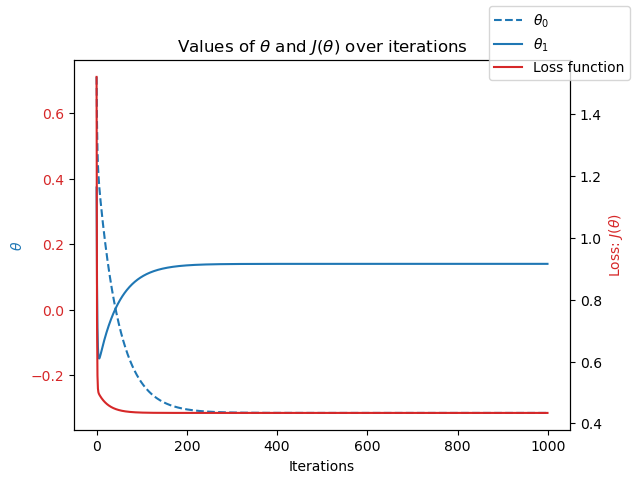


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.3159
Optimal Theta 1: 0.1395
Minimal cost: 0.4335
Iteration of minimal cost: 845


In [178]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 845 iteration, lets set it to 9000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [181]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 781 ms
Wall time: 1.6 s


In [ ]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [185]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=9000 #<---start with the same iterations as above
theta_init=np.array([[-0.3159],[0.1395]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

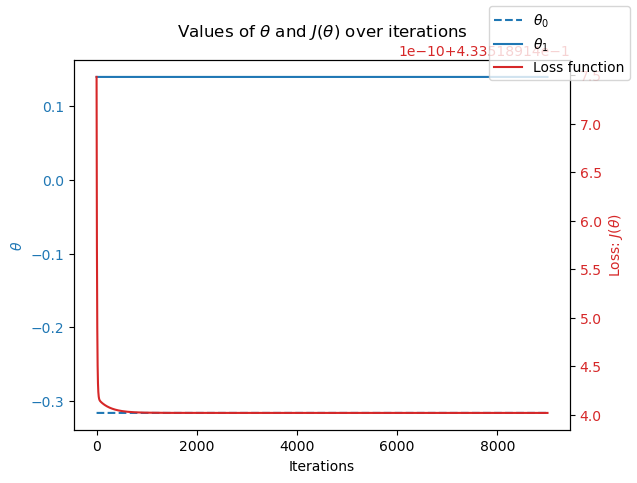


--- Optimization Results ---
Number of iterations: 9000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.3159
Optimal Theta 1: 0.1395
Minimal cost: 0.4335
Iteration of minimal cost: 3579


In [189]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [191]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.44 s
Wall time: 2.16 s


In [192]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

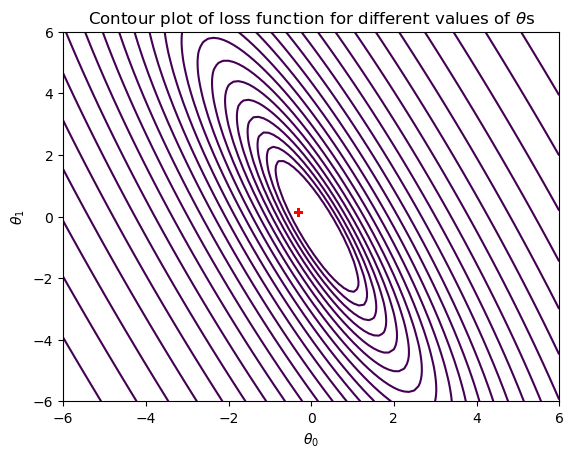

In [195]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.2.2 BUDAPEST
<div id='2.2.2'></div>

In [198]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['BUDAPEST_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [200]:
X.shape, y.shape

((366, 2), (366, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['BUDAPEST_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [204]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].min()

-2.4166643260714715

In [206]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].max()

1.8063974207400058

In [208]:
compute_cost(X,y)

array([0.44887979])

In [210]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 250 ms
Wall time: 473 ms


In [212]:
theta

array([[-0.56441325],
       [ 0.27274869]])

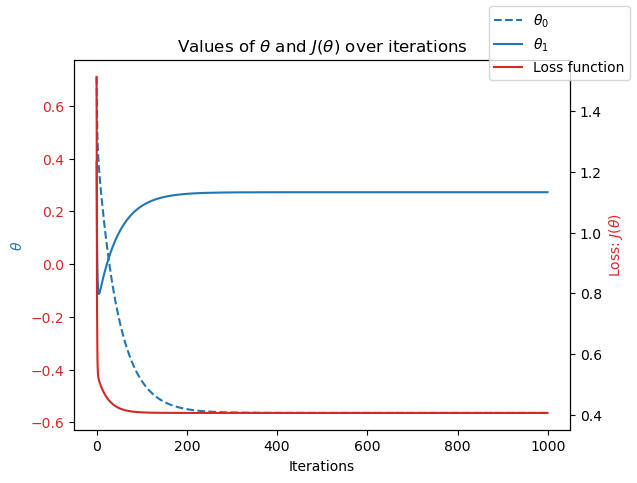


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.5644
Optimal Theta 1: 0.2727
Minimal cost: 0.4053
Iteration of minimal cost: 978


In [214]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 978 iteration, lets set it to 10000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [217]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 969 ms
Wall time: 1.74 s


In [ ]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [221]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=10000 #<---start with the same iterations as above
theta_init=np.array([[-0.5644],[0.2727]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

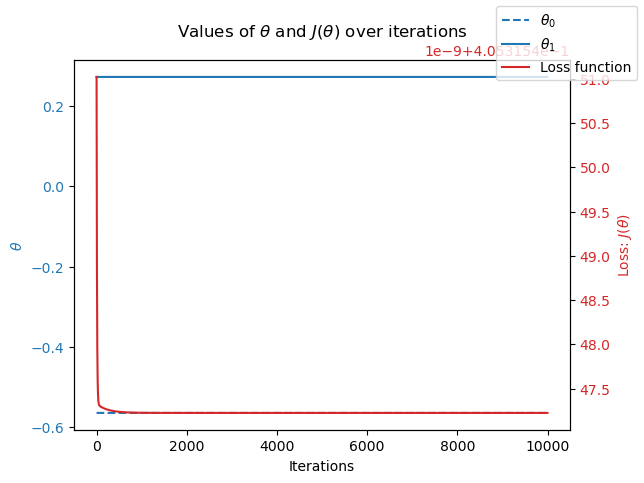


--- Optimization Results ---
Number of iterations: 10000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.5644
Optimal Theta 1: 0.2727
Minimal cost: 0.4053
Iteration of minimal cost: 3576


In [225]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [227]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 797 ms
Wall time: 1.64 s


In [228]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

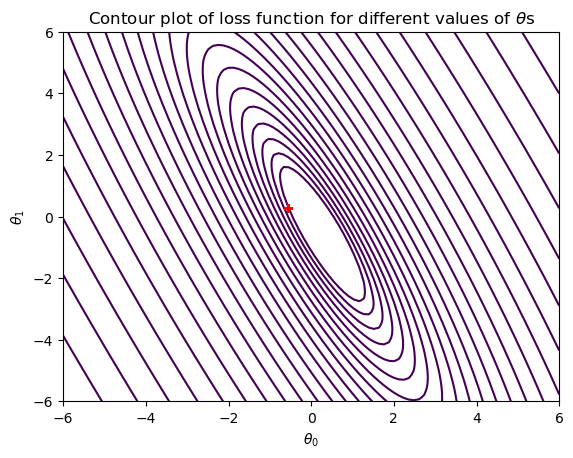

In [231]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.2.3 ROMA
<div id='2.2.3'></div>

In [234]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['ROMA_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [236]:
X.shape, y.shape

((366, 2), (366, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['ROMA_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [240]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].min()

-2.4086101755628473

In [242]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].max()

1.9524861813880554

In [244]:
compute_cost(X,y)

array([0.5052758])

In [246]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 297 ms
Wall time: 461 ms


In [248]:
theta

array([[-0.3112786 ],
       [ 0.22007231]])

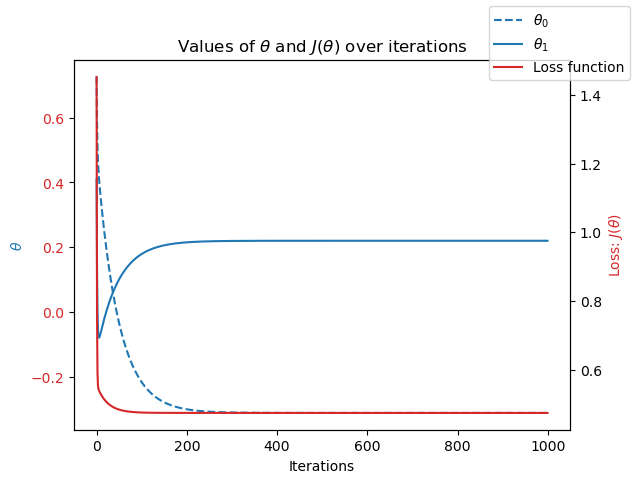


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.3113
Optimal Theta 1: 0.2201
Minimal cost: 0.4740
Iteration of minimal cost: 893


In [250]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 893 iteration, lets set it to 9000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [252]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 734 ms
Wall time: 1.62 s


In [ ]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [256]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=9000 #<---start with the same iterations as above
theta_init=np.array([[-0.3113],[0.2201]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

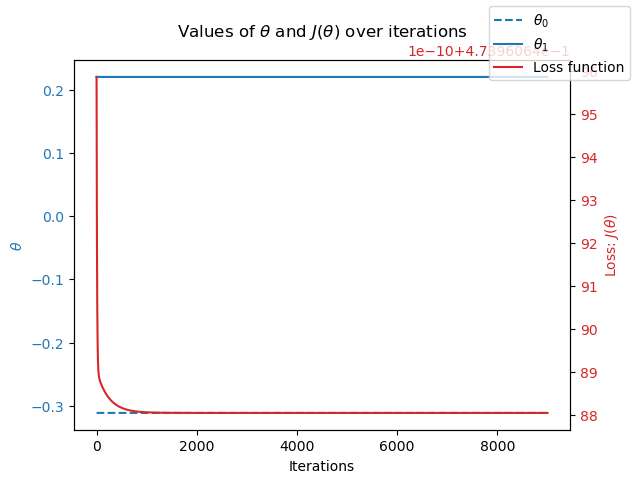


--- Optimization Results ---
Number of iterations: 9000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.3113
Optimal Theta 1: 0.2201
Minimal cost: 0.4740
Iteration of minimal cost: 4161


In [260]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [262]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1 s
Wall time: 1.77 s


In [263]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

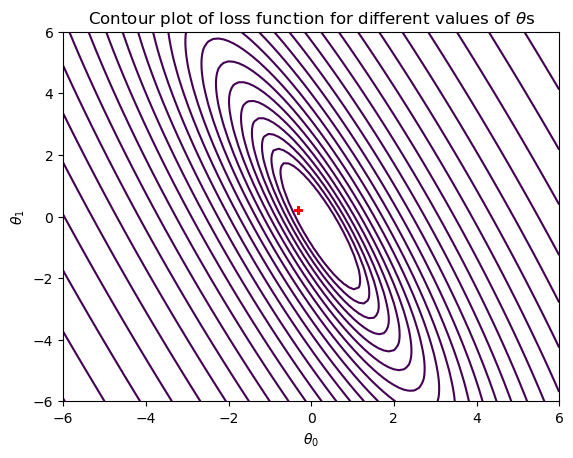

In [266]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

### 2.3 2009
<div id='2.3'></div>

In [269]:
#Reduce your dataset to a single year
dfyear = df[df['DATE'].astype(str).str.contains('2009')] #<-----INSERT YEAR HERE
dfyear

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
17898,2009-01-01,1,-2.063762,-0.910009,-1.731958
17899,2009-01-02,1,-1.734387,-1.431994,-1.888835
17900,2009-01-03,1,-1.757914,-1.448832,-1.857459
17901,2009-01-04,1,-1.816731,-1.819273,-2.202587
17902,2009-01-05,1,-1.640280,-1.903464,-2.516340
...,...,...,...,...,...
18258,2009-12-27,12,-1.052110,-1.465670,-1.104453
18259,2009-12-28,12,-0.969766,-1.431994,-0.853451
18260,2009-12-29,12,-1.005056,-0.556407,-0.194570
18261,2009-12-30,12,-1.169744,-0.118614,-0.257321


In [271]:
dfyear.describe().map(lambda x: f"{x:0.5f}")

,DATE,MONTH,BUDAPEST_temp_mean,ROMA_temp_mean,TOURS_temp_mean
count,365.00000,365.00000,365.00000,365.00000,365.00000
mean,0.5f,6.52603,0.08820,0.17640,0.07925
min,0.5f,1.00000,-2.53430,-2.50964,-2.79872
25%,0.5f,4.00000,-0.79331,-0.87633,-0.63382
50%,0.5f,7.00000,0.24186,-0.00075,0.11918
75%,0.5f,10.00000,0.97120,1.26212,0.91925
max,0.5f,12.00000,2.00638,2.45763,2.28408
std,nan,3.45258,1.05587,1.23380,1.05007


In [273]:
#Pick which weather station you want to use. Below is a 3D visualization of the temperatures for that year.

In [275]:
#Drop the DATE and MONTH data as those numbers are not scaled with the rest.
notempyear = dfyear.drop(['DATE','MONTH'], axis=1)

In [279]:
#We need to make an index for the year. Create a set of data from 1 to 365 (or to 366 if it's a leap year!)
#We'll scale this by 100 as the index is made. This will help the gradient descent converge 366 = 3.66

i = np.arange(0.01,3.66,0.01) #<---needs to be one GREATER than the total number of days
index = pd.DataFrame(data = i, columns = ['index'])
index

,index
0,0.01
1,0.02
2,0.03
3,0.04
4,0.05
...,...
360,3.61
361,3.62
362,3.63
363,3.64


In [281]:
n_rows = dfyear.shape[0]
n_rows

365

#### 2.3.1 TOURS
<div id='2.3.1'></div>

In [284]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['TOURS_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [286]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['TOURS_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [290]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].min()

-2.7987171559391246

In [292]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['TOURS_temp_mean'].max()

2.2840753568864076

In [294]:
compute_cost(X,y)

array([0.55295168])

In [296]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 172 ms
Wall time: 452 ms


In [298]:
theta

array([[-0.44835058],
       [ 0.28830851]])

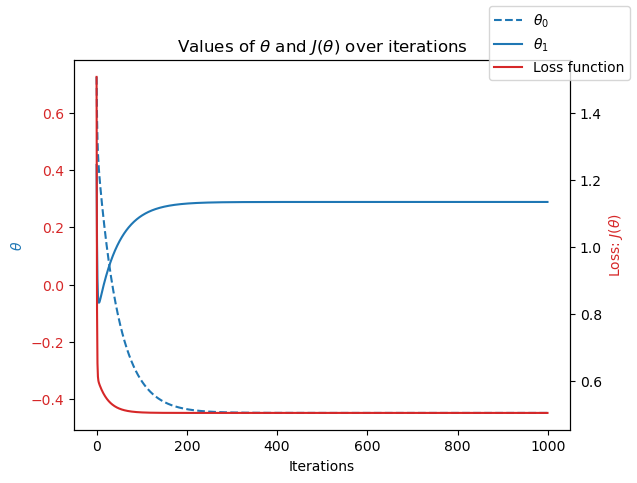


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.4484
Optimal Theta 1: 0.2883
Minimal cost: 0.5037
Iteration of minimal cost: 933


In [300]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 933 iteration, lets set it to 10000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [303]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 1.06 s
Wall time: 1.81 s


In [304]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [307]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=10000 #<---start with the same iterations as above
theta_init=np.array([[-0.4484],[0.2883]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

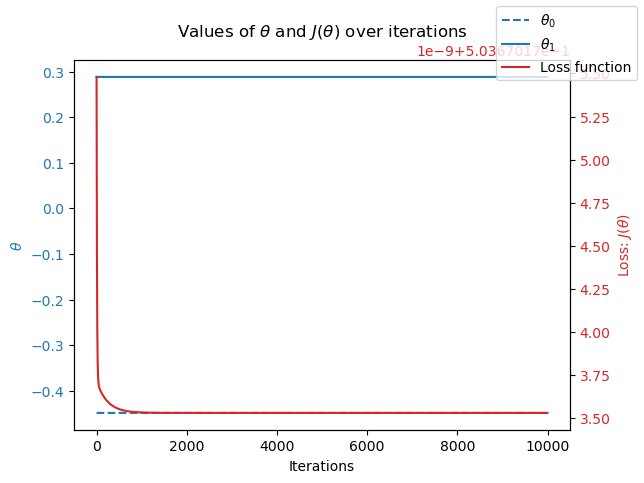


--- Optimization Results ---
Number of iterations: 10000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.4484
Optimal Theta 1: 0.2883
Minimal cost: 0.5037
Iteration of minimal cost: 6033


In [311]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [313]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 766 ms
Wall time: 1.66 s


In [314]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

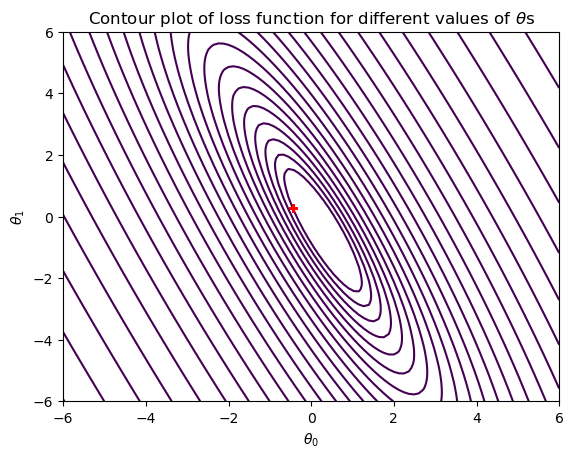

In [317]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.3.2 BUDAPEST
<div id='2.1.2'></div>

In [320]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['BUDAPEST_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [322]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['BUDAPEST_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [326]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].min()

-2.534298358016081

In [328]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['BUDAPEST_temp_mean'].max()

2.0063752750458415

In [330]:
compute_cost(X,y)

array([0.55979194])

In [332]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 203 ms
Wall time: 470 ms


In [334]:
theta

array([[-0.26367751],
       [ 0.19228241]])

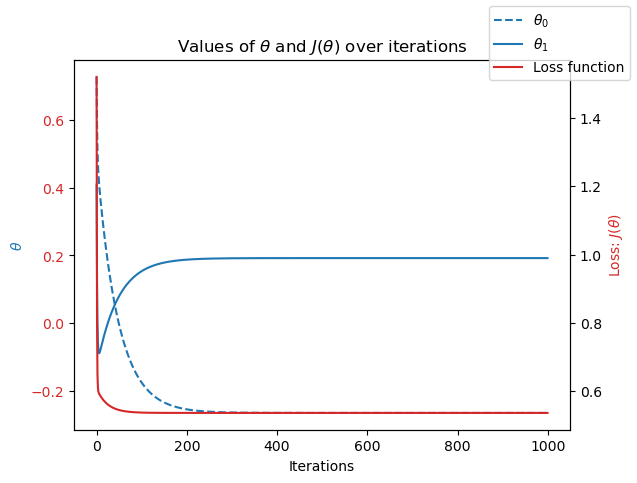


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.2637
Optimal Theta 1: 0.1923
Minimal cost: 0.5354
Iteration of minimal cost: 920


In [336]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 849 iteration, lets set it to 10000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [338]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 922 ms
Wall time: 1.59 s


In [339]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [342]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=10000 #<---start with the same iterations as above
theta_init=np.array([[-0.2637],[0.1923]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

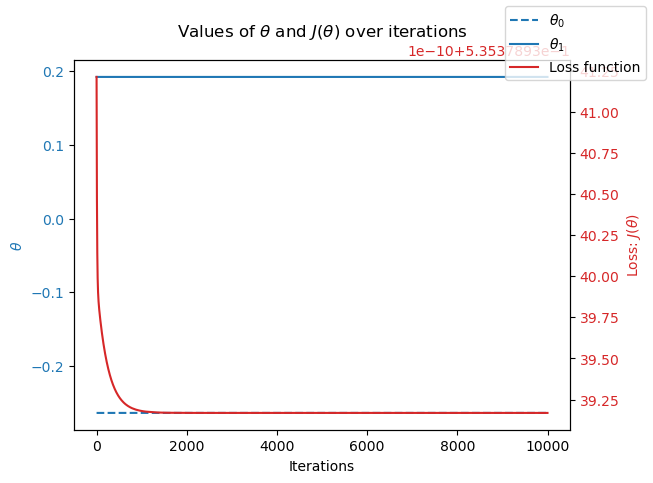


--- Optimization Results ---
Number of iterations: 10000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.2637
Optimal Theta 1: 0.1923
Minimal cost: 0.5354
Iteration of minimal cost: 7163


In [346]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [348]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 828 ms
Wall time: 1.6 s


In [349]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

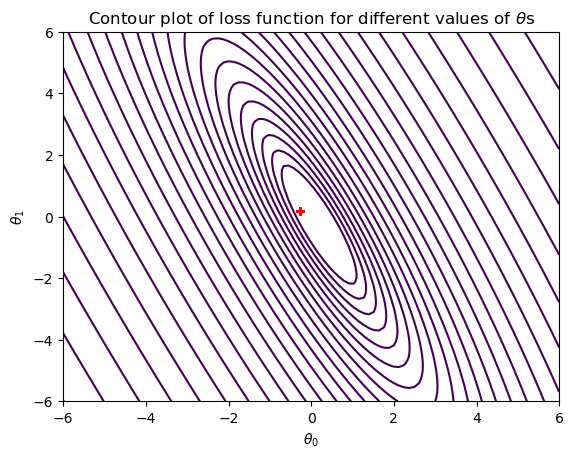

In [352]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()

#### 2.3.3 ROMA
<div id='2.3.3'></div>

In [354]:
#This will translate your chosen weather data into the X and y datasets needed for the optimization function.

X=index.to_numpy().reshape(n_rows,1)
#Represent x_0 as a vector of 1s for vector computation
ones = np.ones((n_rows,1))
X = np.concatenate((ones, X), axis=1)
y=dfyear['ROMA_temp_mean'].to_numpy().reshape(n_rows,1) #<----INSERT WEATHER STATION HERE

In [355]:
X.shape, y.shape

((365, 2), (365, 1))

In [ ]:
#Look at one year of temperature data over time
plt.scatter(x=index['index'], y=dfyear['ROMA_temp_mean']) #<----INSERT WEATHER STATION HERE
plt.xlabel('X'); plt.ylabel('y');
plt.title('Input dataset');
plt.show()

In [357]:
#what is the min temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].min()

-2.509639434797231

In [358]:
#what is the max temperature? (Note gradient descent is not actually finding this number)
dfyear['ROMA_temp_mean'].max()

2.4576324775599745

In [365]:
compute_cost(X,y)

array([0.77460761])

In [367]:
%%time
#This runs your data through a gradiant descent for the starting conditions in 'theta_init.'
#You will need to adjust these numbers

num_iterations=1000 #<---Decide how many iterations you need. Start small and work up. Over 10,000 iterations will take a few seconds.
theta_init=np.array([[1],[1]]) #<---this is where you put the guess for [theta0], [theta1]. Start with 1 and 1.
alpha=0.1 #<---Decide what your step size is. Try values between 0.1 and 0.00001. You will need to adjust your iterations.
#If your solution is not converging, try a smaller step size.
theta, J_history, theta0_history, theta1_history = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

CPU times: total: 281 ms
Wall time: 460 ms


In [369]:
theta

array([[-0.29197065],
       [ 0.25594081]])

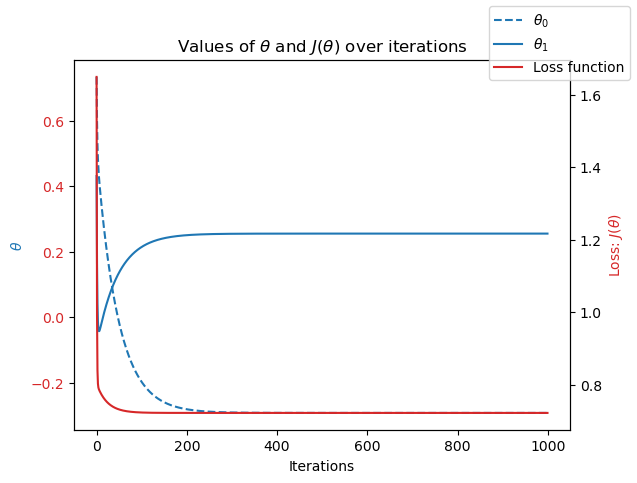


--- Optimization Results ---
Number of iterations: 1000
Learning rate (alpha): 0.1

Optimal Theta 0: -0.2920
Optimal Theta 1: 0.2559
Minimal cost: 0.7227
Iteration of minimal cost: 917


In [371]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history[min_cost_index]
optimal_theta1 = theta1_history[min_cost_index]
minimal_cost = J_history[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")

- We reach a convergence at the 917 iteration, lets set it to 10000 iterations and change the alpha to 0.01
- the optimal thetas are the values corresponding to the lowest cost, let's use them.

In [373]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 812 ms
Wall time: 1.62 s


In [374]:
#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history, y=theta0_history, z=J_history, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history, theta1_history, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

In [377]:
#Rerun the optimization above, but this time start closer to the objective!
#Find where the black line ends near the lowest X/Y/Z coordinate and make that your guess below.

num_iterations=10000 #<---start with the same iterations as above
theta_init=np.array([[-0.2920],[0.2559]]) #<---make a guess as to a more accurate [x],[y] coordinates near the minimum in the graph above.
alpha= 0.01 #<---start with the same step size as above
theta1, J_history1, theta0_history1, theta1_history1 = gradient_descent(X,y, theta_init,
                                                                   alpha, num_iterations)

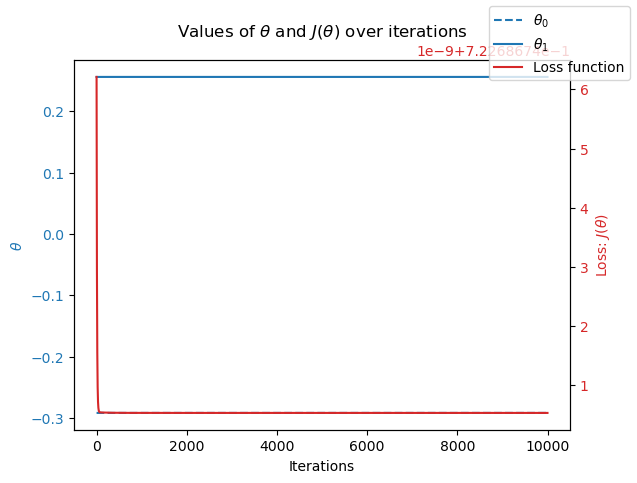


--- Optimization Results ---
Number of iterations: 10000
Learning rate (alpha): 0.01

Optimal Theta 0: -0.2920
Optimal Theta 1: 0.2559
Minimal cost: 0.7227
Iteration of minimal cost: 3252


In [381]:
# Find the index of minimal cost
min_cost_index = np.argmin(J_history1)

# Retrieve thetas corresponding to minimal cost
optimal_theta0 = theta0_history1[min_cost_index]
optimal_theta1 = theta1_history1[min_cost_index]
minimal_cost = J_history1[min_cost_index]

#This will plot your loss, theta0, and theta1.If the result looks like a straight line, it's not converging on an answer!
#Your loss (red) should be trending toward 0.

fig, ax1 = plt.subplots()

# plot thetas over time
color='tab:blue'
ax1.plot(theta0_history1, label='$\\theta_{0}$', linestyle='--', color=color)
ax1.plot(theta1_history1, label='$\\theta_{1}$', linestyle='-', color=color)
# ax1.legend()
ax1.set_xlabel('Iterations'); ax1.set_ylabel('$\\theta$', color=color);
ax1.tick_params(axis='y', labelcolor=color)

# plot loss function over time
color='tab:red'
ax2 = ax1.twinx()
ax2.plot(J_history1, label='Loss function', color=color)
ax2.set_title('Values of $\\theta$ and $J(\\theta)$ over iterations')
ax2.set_ylabel('Loss: $J(\\theta)$', color=color)
ax2.tick_params(axis='y', labelcolor=color)

# ax2.legend();
fig.legend();
plt.show()

# Print optimization results
print("\n--- Optimization Results ---")
print(f"Number of iterations: {num_iterations}")
print(f"Learning rate (alpha): {alpha}")
print(f"\nOptimal Theta 0: {optimal_theta0:.4f}")
print(f"Optimal Theta 1: {optimal_theta1:.4f}")
print(f"Minimal cost: {minimal_cost:.4f}")
print(f"Iteration of minimal cost: {min_cost_index}")


In [383]:
%%time
# theta range
theta0_vals = np.linspace(-6,6,100) #Look in the chart above for the limits of where theta0 and theta1 appear.
theta1_vals = np.linspace(-6,6,100) #Put those values as the first two "linspace" numbers in these lines
                                      #Select with large margins, maybe +/- 10
J_vals = np.zeros((len(theta0_vals), len(theta1_vals)))

# compute cost for each combination of theta
c1=0; c2=0
for i in theta0_vals:
    for j in theta1_vals:
        t = np.array([i, j])
        J_vals[c1][c2] = compute_cost(X, y, t.transpose()).tolist()[0]
        c2=c2+1
    c1=c1+1
    c2=0 # reinitialize to 0

CPU times: total: 734 ms
Wall time: 1.65 s


In [384]:

#X = Theta0
#Y - Theta1
#Z = Loss
#black line = path of loss function over the iterations.
#Find where it is closest to 0 in X and Y!

#you can click/hold in the graph below to rotate!

line_marker = dict(color='#101010', width=2)
fig = go.Figure()
fig.add_surface(x=theta1_vals, y=theta0_vals, z=J_vals)
fig.add_scatter3d(x=theta1_history1, y=theta0_history1, z=J_history1, line=line_marker, name='')
#The below line adds a graph of just the loss over iterations in a 2D plane
plt.plot(theta0_history1, theta1_history1, 'r+');
fig.update_layout(title='Loss function for different thetas', autosize=True,
                  width=600, height=600, xaxis_title='theta0', 
                 yaxis_title='theta1')
fig.show()

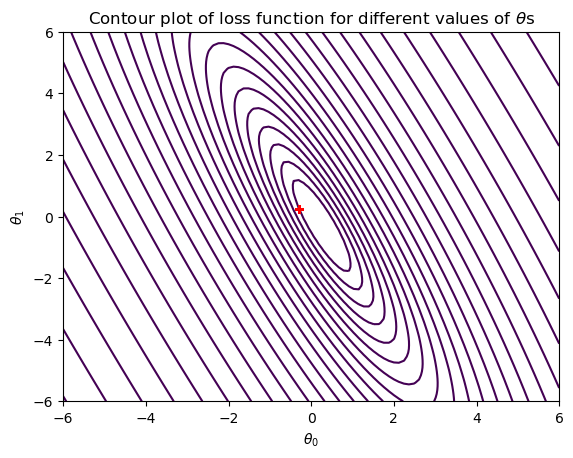

In [387]:
#This plot shows the convergence similar to above, but only in the X/Y plane (there's no height)

plt.contour(theta0_vals, theta1_vals, J_vals, levels = np.logspace(0,10,100))
plt.xlabel('$\\theta_{0}$'); plt.ylabel("$\\theta_{1}$")
plt.title("Contour plot of loss function for different values of $\\theta$s");
plt.plot(theta0_history1, theta1_history1, 'r+');
plt.show()